## Preparing the data

In [ ]:
from google.colab import drive

drive.mount('/content/drive', force_remount=True)

In [ ]:
! git clone https://github.com/Mohammadjafari80/Panorma

In [ ]:
!pip install opencv-contrib-python==3.4.2.17
!pip install opencv-python

In [ ]:
! pip install imageio

In [ ]:
% cd Panorma

In [6]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pylab as plt
import glob
import imageio
import os
from numpy.core.numeric import argwhere
from math import factorial

## i had consultation with *Saeed Razavi* & *Nime Kelidari*.



# Loading the Video Frames

In [7]:
video = cv2.VideoCapture('video.mp4')
frames = []

In [8]:
while True:
    ret, frame = video.read()
    if not ret:
        break
    frames.append(frame)

In [9]:
HEIGHT, WIDTH = frames[0].shape[:2]

In [10]:
P = [(0, 0), (0, HEIGHT-1), (WIDTH-1, HEIGHT-1), (WIDTH-1, 0)]

In [11]:
LOAD_HOMOGRAPHIES = True
LOAD_BACKGROUND_IMG = True
HOMOGRAPHIES_PATH = '/content/'
BACKGOUND_IMG_PATH = '/content/'
TEMP_FILES_PATH = '/content/temp/'
PARTION_FILES_PATH = '/content/parts/'
SAVE_PATH = '../'
STEPS = 100
ALL_PATHS = [HOMOGRAPHIES_PATH, BACKGOUND_IMG_PATH, TEMP_FILES_PATH, PARTION_FILES_PATH]

In [12]:
for path in ALL_PATHS:
  if not os.path.exists(path):
    os.makedirs(path)

# Main Functions

In [13]:
def concat_h(img1, img2):
    img2 = img2.copy()
    if img2.shape[0] > img1.shape[0]:
        ratio = img1.shape[0] / img2.shape[0]
        img2 = cv2.resize(img2, (int(img2.shape[1] * ratio), img1.shape[0]))
    black_pixels = np.zeros(shape=(img1.shape[0], img2.shape[1], 3)).astype(np.uint8)
    black_pixels[: img2.shape[0], :] = img2
    return cv2.hconcat([img1, black_pixels])

In [14]:
def feature_matching(img1, img2, n_features=1000):
    orb = cv2.ORB_create(n_features)
    kp1, des1 = orb.detectAndCompute(img1, None)
    kp2, des2 = orb.detectAndCompute(img2, None)
    print(len(kp1))
    index_params = dict(algorithm=6,
                        table_number=6,
                        key_size=12,
                        multi_probe_level=2)

    flann = cv2.FlannBasedMatcher(index_params)
    matches = flann.knnMatch(des1, des2, k=2)
    print(len(matches))

    good_matches = []
    for m, n in matches:
        if m.distance < 0.50 * n.distance:
            good_matches.append(m)
    print(len(good_matches))
    print('*' * 50)
    src_points = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_points = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    H, mask = cv2.findHomography(src_points, dst_points, cv2.RANSAC, 15)

    return good_matches, H


def feature_matching_accurate(img1, img2):
    sift = cv2.xfeatures2d.SIFT_create()
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)
    flann = cv2.FlannBasedMatcher()
    matches = flann.knnMatch(des1, des2, k=2)
    good_matches = []
    for m, n in matches:
        if m.distance < 0.60 * n.distance:
            good_matches.append(m)

    src_points = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_points = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    H, mask = cv2.findHomography(src_points, dst_points, cv2.RANSAC, 4)

    return good_matches, H


In [15]:
def blend(mask_left, img_left, mask_right, img_right):
    mask_l = np.zeros_like(img_left, dtype=np.float32)
    mask_r = np.zeros_like(img_right, dtype=np.float32)

    for i in range(3):
        mask_l[:, :, i] = mask_left
        mask_r[:, :, i] = mask_right

    image_1 = np.multiply(mask_l, img_left, dtype=np.float32)
    image_2 = np.multiply(mask_r, img_right, dtype=np.float32)

    return (image_1 + image_2).astype(np.uint8)

In [16]:
def concatenate(files_path, name, save_path='./', temp_path=''):
    stringa = "ffmpeg -i \"concat:"
    elenco_video = glob.glob(files_path + "*.mp4")
    elenco_video = sorted(elenco_video)
    elenco_file_temp = []
    for f in elenco_video:
      file = temp_path + "temp" + str(elenco_video.index(f) + 1) + ".ts"
      os.system("ffmpeg -i " + f + " -c copy -bsf:v h264_mp4toannexb -f mpegts " + file)
      elenco_file_temp.append(file)
    for f in elenco_file_temp:
      stringa += f
      if elenco_file_temp.index(f) != len(elenco_file_temp)-1:
        stringa += "|"
      else:
        stringa += f"\" -c copy  -bsf:a aac_adtstoasc {save_path}{name}.mp4"
    os.system(stringa)

    for filePath in elenco_video:
      try:
          os.remove(filePath)
      except OSError:
          print("Error while deleting file")

    for filePath in elenco_file_temp:
      try:
          os.remove(filePath)
      except OSError:
          print("Error while deleting file")
    

# Part 1 - Stitch 2 Images

First of all we seperate the 270th and 450th frame into some variable. Then we detect and corresponding points in these 2 images with SIFT method. Then we compute the homorgraphy between these 2 images by using RANSAC as an outlier detection method. Now we have a matrix H which maps frame 270 to frame 450.

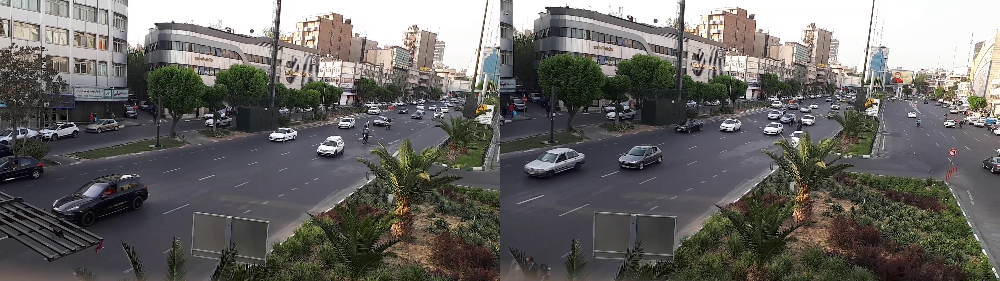

In [17]:
cv2_imshow(concat_h(frames[269], frames[449]))

In [18]:
matches, H = feature_matching_accurate(frames[269], frames[449])

## Coresponding Rectangles
In order to do that first we draw a random rectangle on frame 450, Since we want compare their field of view, we take it big enough such that an adequate portion of the image is selected. Then we store the points coordinates and transform them by using inverse of matrix H. What we get is the coordinates of the same points in the 270th frame. We simply draw a polygon with those 4 points. 

As we can see both images represent the same view of the images.

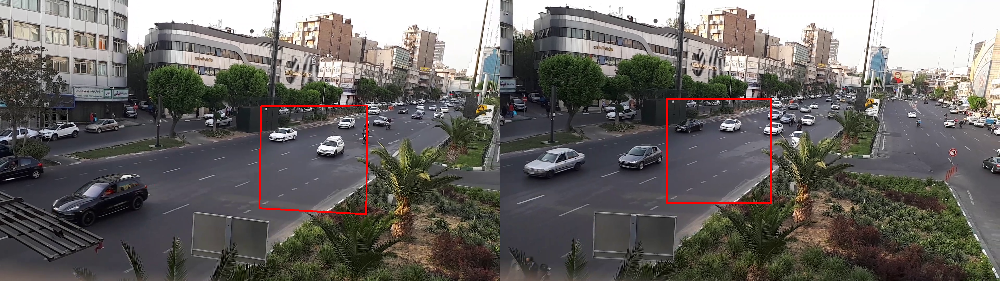

In [19]:
width = 400
x, y = 640, 380
pts = np.array([[x, y], [x+width, y], [x+width, y+width], [x, y+width]], np.int32)
pts = pts.reshape((-1, 1, 2))
isClosed = True
color = (0, 0, 255)
thickness = 5

image_1_rect = cv2.polylines(frames[449].copy(), [pts], 
                      isClosed, color, 
                      thickness)

H_inv = np.linalg.inv(H)
pts_target = cv2.perspectiveTransform(np.float32(pts), H_inv).astype(np.int32)

image_2_rect = cv2.polylines(frames[269].copy(), [pts_target], 
                            isClosed, color, 
                            thickness)

cv2.imwrite(f'{SAVE_PATH}res01-450-rect.jpg', image_1_rect)
cv2.imwrite(f'{SAVE_PATH}res02-270-rect.jpg', image_2_rect)

cv2_imshow(concat_h(image_2_rect, image_1_rect))

## Image Stitching

If we transform 270th frame to 450th frame we observe that a large area of the image gets placed in negative coordinates. In order to solve that we consider the left-most top-most pixel of the frame 250 which is $(0, 0)$. Then we transform it the new coodinates in frame 450. Imagine those coordinates are represented by $(x,y). In order to shift the images to the beginig of the canvas, we consider this translation matrix.
<br />
<br />


$$
Translation =
\begin{bmatrix}
    1   &   0 & -x  \\
    0   &   1 & -y \\
    0   &   0 & 1
\end{bmatrix}
$$

<br />

If we multiply them to new coordinates they get transformed to inside of the canvas. Also we consider the new image size big enough such that the image doesn't exceed the borders.

In [20]:
pts_corner = np.array([[-50, -50]], np.float32).reshape((-1, 1, 2))
pts_page = cv2.perspectiveTransform(np.float32(pts_corner), H).astype(np.int32)
transformation_matrix = np.array([[1 , 0, pts_corner[0, 0, 0] - pts_page[0, 0, 0]],
                                  [0 , 1, pts_corner[0, 0, 1] - pts_page[0, 0, 1]],
                                  [0, 0, 1]])

In [21]:
corrected_img = cv2.warpPerspective(frames[269], transformation_matrix @ H, (int(frames[449].shape[1] * 1.4), int(frames[449].shape[0] * 1.3)))
corrected_img_2 = cv2.warpPerspective(frames[449], transformation_matrix, (int(frames[449].shape[1] * 1.4), int(frames[449].shape[0] * 1.3)))

In [22]:
pts_overlap = np.array([[0, 0], [frames[449].shape[1], 0]], np.float32).reshape((-1, 1, 2))
pts_overlap = cv2.perspectiveTransform(np.float32(pts_overlap), transformation_matrix).astype(np.int32)

In [23]:
pts_1 = cv2.perspectiveTransform(np.float32(P).reshape(-1, 1, 2), transformation_matrix @ H).astype(np.int32)
pts_2 = cv2.perspectiveTransform(np.float32(P).reshape(-1, 1, 2), transformation_matrix).astype(np.int32)

In order to merge them we simply consider coordinates of 4 corners of the image in 450th frame space and then we draw a white mask for each of them. As what we were purposed, in the intersetion area, we place 450th frame pixels. So we simply subtract the intersection of these 2 masks from 270th frame.

In [24]:
rows, cols = corrected_img.shape[:2]
frame_mask_left = np.zeros((rows, cols))
frame_mask_right = np.zeros((rows, cols))
cv2.fillPoly(frame_mask_left, pts = [pts_1], color =1)
cv2.fillPoly(frame_mask_right, pts = [pts_2], color =1)
intersection = frame_mask_left * frame_mask_right
frame_mask_left = frame_mask_left - intersection
frame_mask_right = frame_mask_right

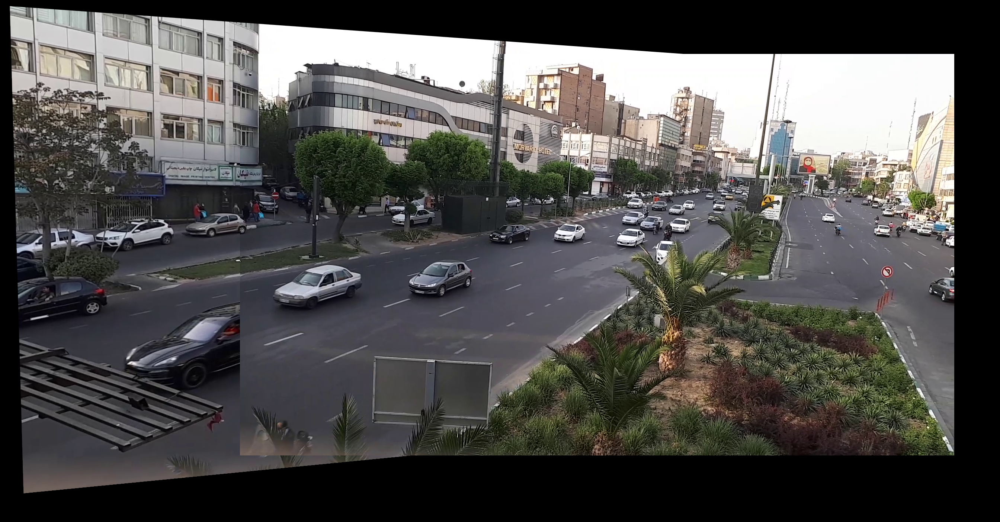

In [25]:
blended = blend(frame_mask_left, corrected_img, frame_mask_right, corrected_img_2)
cv2.imwrite(f'{SAVE_PATH}res03-270-450-panorama.jpg', blended)
cv2_imshow(blended)

# Part 2 - Panorama with 5 frames

In this part we have to almost repeat the same process with 2 difference.

1. There are 5 frames instead of 2.
2. We have to Merge them ins such a way the transition between the framees is almost seamless.

for the first part, we just repeat the same procedure for 4 times between the consecutive images and put them on the black canvas that we have.

</br>
$$ 90 → 270$$
$$ 270 → 450$$
$$ 450 → 630$$
$$ 630 → 830$$

</br>

for the second part we have to use minimum cut path algorithm to find the path that seperates consecutive images with maximum similarity. We can't use Gaussian or Laplacian pyramid directly since we have a dynamic scene. so we first find path in their inersection area and then we smooth the transition of 0 to 1 for each mask (60 pixel wide transition instead of a hard cut). In this way image color blend really well together and create a unified seamless image.

In our minimum cut path algorithm we penalize black pixels in order to make the path inside of the intersection area as mush as possible.

After blending 2 frames we can see that even though that some parts of a frame don't collide with other frames, they're not in the final canvas. In order to solve that we just simply place value of 1 in the mentioned areas. Therefore we might we some slight edges at the top or bottom of the panorama image, but it's certainly a more complete version of the image.

> I used the same code for minimum cut path that I wrote for texture synthesis question of **Image Processing** course with some slight changes.

In [26]:
def minimum_cost_path(section_1, section_2):
    S = -10
    rows, cols = section_1.shape[:2]
    section_1, section_2 = section_1.astype(np.float32), section_2.astype(np.float32)
    DP = np.zeros((rows, cols), dtype=np.float32)

    for i in range(rows):
      for j in range(cols):
        B, G, R = section_1[i, j]
        if B == 0 and G == 0 and R == 0:
          section_1[i, j] = [S, S, S]

      
    difference_matrix = np.sum(np.abs(section_1 - section_2)**2, axis=2)
    DP[0, :] = difference_matrix[0, :]
    backtrace = np.zeros((rows, cols)) # 1:UP-LEFT  2:UP-CENTER  3:UP-RIGHT

    for row in range(rows):
        for col in range(cols):
            # Dynamic Programming
            possible_values = []

            if col == 0:
                possible_values = [1e12, DP[row-1, col], DP[row-1, col + 1]]
            elif col == cols - 1:
                possible_values = [DP[row-1, col - 1], DP[row-1, col], 1e12]
            else:
                possible_values = [DP[row-1, col - 1], DP[row-1, col], DP[row-1, col + 1]]

            DP[row, col] = min(possible_values)
            backtrace[row, col] = possible_values.index(DP[row, col]) + 1
            DP[row, col] += difference_matrix[row, col]

    return DP, backtrace

def backtrace_path(DP, backtrace, vetical=True):
    rows, cols = DP.shape
    row_index = rows - 1
    col_index = np.argmin(DP[row_index])
    
    path = []
    while row_index >= 0 :
        path.append((row_index, col_index) if vetical else (col_index, row_index))
        if backtrace[row_index, col_index] == 1:
            col_index -= 1
        elif backtrace[row_index, col_index] == 3:
            col_index += 1
        row_index -= 1
    
    return path[::-1]

def find_minimum_cost_path(section_1, section_2, vertical=True):
    DP, backtrace = minimum_cost_path(section_1, section_2) if vertical else\
                    minimum_cost_path(cv2.transpose(section_1),
                                      cv2.transpose(section_2))
    
    return backtrace_path(DP, backtrace, vertical)

def create_blend_masks_horizontal(path, overlap_shape):
    rows, cols = overlap_shape
    mask_left = np.zeros((rows, cols))
    mask_right = np.ones((rows, cols))
    gap = 30
    for row, col in path:
        mask_left[row, :col] = 1
        mask_left[row, max(col-gap, 0):col] = np.linspace(1, 0.5, num=col-  max(col-gap, 0), endpoint=False)
        mask_left[row, col] = 0.5
        mask_left[row, col+1:] = 0
        mask_left[row, col+1: min(col+gap, cols)] = np.linspace(0.5, 0, num=min(col+gap, cols) - col - 1, endpoint=True) 

    return mask_left, mask_right - mask_left

def handle_masks(section_1, section_2, start, end, pts_1, pts_2):
    rows, cols = section_1.shape[:2]
    frame_mask_left = np.zeros((rows, cols)).astype(np.float32)
    frame_mask_right = np.zeros((rows, cols)).astype(np.float32)
    cv2.fillPoly(frame_mask_left, pts = [pts_1], color =1, lineType=cv2.LINE_AA)
    cv2.fillPoly(frame_mask_right, pts = [pts_2], color =1, lineType=cv2.LINE_AA)
    intersection = frame_mask_left * frame_mask_right
    frame_mask_left = frame_mask_left - intersection
    frame_mask_right = frame_mask_right - intersection
    frame_mask_left = cv2.dilate(frame_mask_left.copy(), np.ones((3, 3)), iterations=5)
    frame_mask_left = cv2.blur(frame_mask_left.copy(),(9, 9))
    mask_left, mask_right = np.zeros((rows, cols), dtype=np.float32), np.zeros((rows, cols),  dtype=np.float32)
    mask_left[:, :start] = 1
    mask_right[:, end:] = 1
    path_v = []
    path_v = find_minimum_cost_path(section_1[:, start:end], section_2[:, start:end], True)
    mask_left_overlap, mask_right_overlap = create_blend_masks_horizontal(path_v, (section_1[:, start:end].shape[:2]))
    mask_left[:, start:end] = mask_left_overlap
    mask_right[:, start:end] = mask_right_overlap
    a = np.maximum(mask_left, frame_mask_left)
    b = 1- a
    return a, b

We use SIFT algorithm to find matches between consecutive frames since it's one of the most robust ones.

In [27]:
frames_indexes = [90, 270, 450, 630, 810]
panorama_frames = [frames[i-1] for i in frames_indexes]
homographies = []
for i in range(4):
  m, H = feature_matching_accurate(panorama_frames[i], panorama_frames[i+1])
  homographies.append(H)

$$H_{90 → 450} =  H_{90 → 270} \times H_{270 → 450}$$

$$H_{270 → 450} =  H_{270 → 450}$$

$$H_{450 → 450} =  I$$

$$H_{630 → 450} =  H_{450 → 630}^{-1}$$

$$H_{810 → 450} =  H_{630 → 810}^{-1} \times H_{450 → 630}^{-1}$$

In [28]:
final_homographies = [homographies[0] @ homographies[1], homographies[1], np.eye(3), np.linalg.inv(homographies[2]), np.linalg.inv(homographies[3] @ homographies[2])]

In [29]:
pts_corner = np.array([[-50, -50]], np.float32).reshape((-1, 1, 2))
pts_page = cv2.perspectiveTransform(np.float32(pts_corner), final_homographies[0]).astype(np.int32)
transformation_matrix = np.array([[1 , 0, pts_corner[0, 0, 0] - pts_page[0, 0, 0]],
                                  [0 , 1, pts_corner[0, 0, 1] - pts_page[0, 0, 1]],
                                  [0, 0, 1]])

In [30]:
transformed_frames = [cv2.warpPerspective(panorama_frames[i], transformation_matrix @  final_homographies[i], (int(WIDTH * 2.8), int(HEIGHT * 2.2))) for i in range(5)]

Here we transform each consecutive pair of frames with its homorgraphy matrix and then we blend the using the algorithm we discussed earlier.

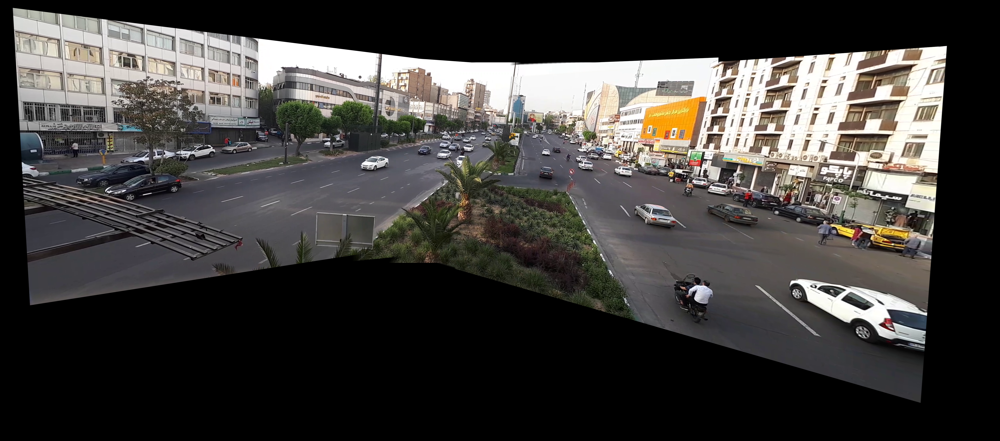

In [31]:
rows, cols = transformed_frames[0].shape[:2]
final_image = transformed_frames[0].copy()
for i in range(4):
  pts_1 = cv2.perspectiveTransform(np.float32(P).reshape(-1, 1, 2), transformation_matrix @ final_homographies[i]).astype(np.int32)
  pts_2 = cv2.perspectiveTransform(np.float32(P).reshape(-1, 1, 2), transformation_matrix @ final_homographies[i+1]).astype(np.int32)
  end = np.max(pts_1[2:, :,0])
  start = np.min(pts_2[:2, :,0])
  frame_mask_left, frame_mask_right = handle_masks(final_image, transformed_frames[i+1], start, end, pts_1, pts_2)
  final_image = blend(frame_mask_left, final_image, frame_mask_right, transformed_frames[i+1])

cv2.imwrite(f'{SAVE_PATH}res04-key-frames-panorama.jpg', final_image)
cv2_imshow(final_image)

# Part 3 - Panoramic Video

For this part we have to calculate the homography matrix from each frame to 450th frame. But since some margin frames don't have an intersection with 450th frame, we need to use keyframes as bridges.
But even if do that the final result will contain some major outliers. We use several approaches for minimizing this issue. 

1. Run the same algorithm with different number of keyframes. (5, 9, 11, 13, 15, 17)
2. Run the same algorithm with different number of found fatures (ORB Algorithm)

Finally I took the average of all those matrices to minimize its error. T
We can use several algorithms for feature detection and matching. While SIFT is a really robust algorithm, it takes a  considerable amount of time to perform for all those matrices. ORB is an alternative which provides much faster runtime while producing promising results.

I performed this algorithm with various parameters and used its mean as my final homography.

</br>

| Number of Keyframes 	| 5 	| 7 	| 9 	| 11 	| 13 	| 15 	| 17 	|
|---------------------	|:-:	|:-:	|:-:	|:--:	|:--:	|:--:	|:--:	|
| SIFT                	| ✓ 	| ✓ 	| ✓ 	| ✓  	| ✓  	| ✓  	| ✓  	|
| ORB                 	| ✓ with 10000 points 	|   	 | ✓ with 15000 & 20000 points 	|    	|    	|    	|    	|

</br>


Finally I just transformed each frame by its homography matrix and recorded a frame. Since it takes a huge amount of memory, I made 30 one-second videos and then finally merged them using ffmpeg.

In [32]:
import glob

features_count = 10000

all_homographies = []
if not LOAD_HOMOGRAPHIES:
  key_frame_list = [5, 7, 9, 11, 13, 15, 17]
  for kf in key_frame_list:
    print(f'KF is {kf}')
    interval = 900 // kf
    total_keyframes = kf
    frames_indexes = np.linspace(interval // 2, 900 - interval // 2, total_keyframes).astype(np.int32)
    print(frames_indexes)
    panorama_frames = [frames[i - 1] for i in frames_indexes]
    homographies = []
    for i in range(total_keyframes - 1):
        m, H = feature_matching(panorama_frames[i], panorama_frames[i + 1], 25000)
        homographies.append(H)

    final_homographies = [None for i in range(900)]
    final_homographies[449] = np.eye(3)
    middle = (total_keyframes) // 2
    mid_interval = interval // 2

    for i in range(900):
        print(f'Frame {i}')
        part = (i + 1) // mid_interval
        target = middle
        H = np.eye(3)
        if i < 450:
            target = (part + 2) // 2
            m, H = feature_matching(frames[i], panorama_frames[target], n_features=features_count + i * 6)
        elif i > 450:
            target = (part - 2) // 2
            m, H = feature_matching(frames[i], panorama_frames[target], n_features=features_count + i * 6)

        if target == middle:
            H = H
        elif target > middle:
            for j in range(target - 1, middle - 1, -1):
                H = H @ np.linalg.inv(homographies[j])
        else:
            for j in range(target, middle, 1):
                H = H @ homographies[j]

        final_homographies[i] = H

    all_homographies.append(final_homographies)
else:
    homography_path = glob.glob('/content/' + "*.npy")
    for p in homography_path:
      all_homographies.append(np.load(p))

Here we take the average of all homographies that we have been calculating.

In [33]:
final_homographies = np.mean(np.array(all_homographies), axis=0)

In [34]:
pts_corner = np.array([[-50, -50]], np.float32).reshape((-1, 1, 2))
pts_page = cv2.perspectiveTransform(np.float32(pts_corner), final_homographies[0]).astype(np.int32)
transformation_matrix = np.array([[1 , 0, pts_corner[0, 0, 0] - pts_page[0, 0, 0]],
                                  [0 , 1, pts_corner[0, 0, 1] - pts_page[0, 0, 1]],
                                  [0, 0, 1]])

Here we save 30 files and then concatenate them using FFMPEG.

In [35]:
STEPS = 30
for i in range(STEPS):
  length = 900 // STEPS
  images = [cv2.warpPerspective(frames[i], transformation_matrix @  final_homographies[i], (int(WIDTH * 3.3), int(HEIGHT * 2.5))) for i in range(i * length, (i+1) * length)]
  images = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in images]
  imageio.mimsave(f'{PARTION_FILES_PATH}{i+1:03}.mp4', images, fps=30, macro_block_size = None)

In [36]:
concatenate(PARTION_FILES_PATH, 'res05-reference-plane', SAVE_PATH, TEMP_FILES_PATH)

# Part 4 - Background Panorama

In order to create this part we have to examine color of each pixel in every frame. So we store pixel value of each pixel for every frame that it is included within the mask of that frame.
We can assume that each pixel has the color of the background most of the times. If we assume that more than half of the recorded values belong to background we can just simply get that value by using the median over the stored pixel values. Because if more than half of the data is from backgound, the middle value (sorted) belongs to background as well. So we just calculate the median of each pixel over all the values that it takes.

Since the image is really large and have to sotre their state for 900 frames, we divide it into different patches and do the same for only one patch at the time. Finally we merge them to get the final output.

The bigger the patch, the less we have to iterate over the frames.

In order to make the computations little faster we use a simple huristics. Since camera moves from left ot right we can assume that if a frame passes a patch and have no intersection with it anymore, it probably won't have intersections with next frames too. So we skip the patch when a frame is passed and hasn't have intersection with the patch for over 5 frames.


## Bounding Box

In [37]:
full_mask = np.zeros(shape = (int(HEIGHT * 2.5), int(WIDTH * 3.3))).astype(np.float32)

In [38]:
for i in range(900):
  current_points = cv2.perspectiveTransform(np.float32(P).reshape(-1, 1, 2), transformation_matrix @ final_homographies[i]).astype(np.int32)
  cv2.fillPoly(full_mask, pts = [current_points], color =1)

In [39]:
w, h = 6000, 2600

In [40]:
bounds = [(0, 0), (w, 0), (w, h), (0, h)]

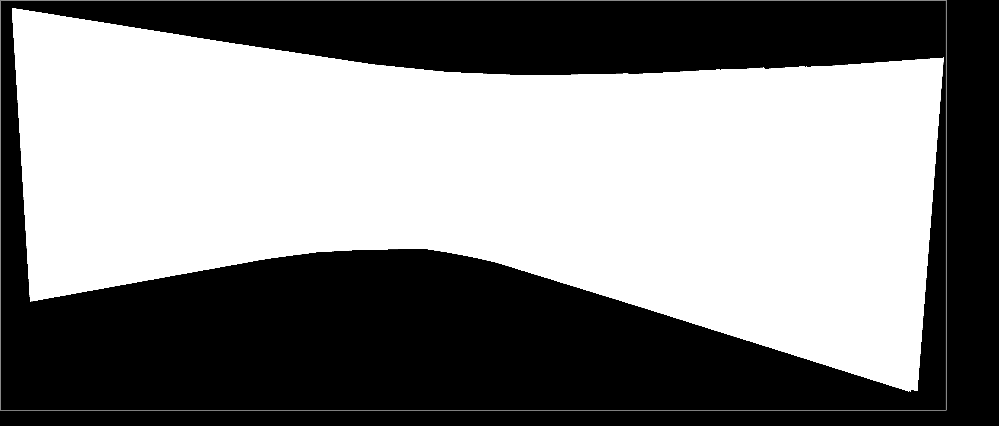

In [41]:
bounding_box = cv2.polylines((full_mask * 255).copy(), np.array([bounds]), True, color=128, thickness =5)
cv2_imshow(bounding_box)

## Vertical Patches

In [42]:
l = 1200

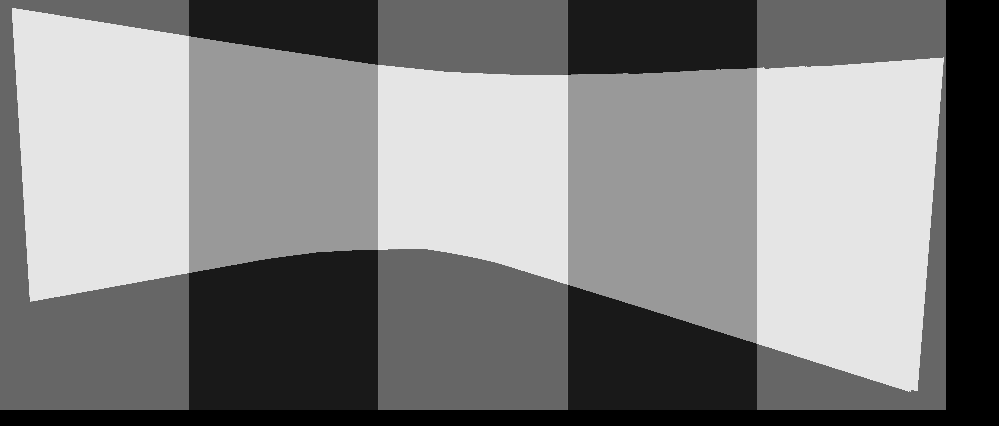

In [43]:
regions = np.zeros(shape = (int(HEIGHT * 2.5), int(WIDTH * 3.3))).astype(np.float32)
for i in range(w//l):
  current_points = [(int(i * l), 0), (int((i+1) * l), 0), (int((i+1) * l), h), (int(i * l), h)]
  current_points = np.float32(current_points).reshape(-1, 1, 2).astype(np.int32)
  cv2.fillPoly(regions, pts = [current_points], color = 0.8 if i % 2 == 0 else 0.2)

cv2_imshow(255 * (0.5 * full_mask + 0.5 * regions))

In [44]:
import statistics

background_img = np.zeros(shape = (int(HEIGHT * 2.5), int(WIDTH * 3.3), 3)).astype(np.uint8)

if not LOAD_BACKGROUND_IMG:
  begin_row = 0
  end_row = h
  last_start = 0

  for j in range(w//l):
    print(f'patch {j}')
    did_reach = False
    empty_count = 0
    begin_col = j * l
    end_col = ( j + 1 ) * l
    current_patch = np.zeros(shape=(h, l, 900, 3), dtype=np.uint8)
    anomaly_mask = np.zeros(shape=(h, l, 900), dtype=bool)
    current_last_start = last_start
    for i in range(last_start, 900):

      if empty_count > 5:
        break

      current_mask = np.zeros_like(full_mask)
      current_points = cv2.perspectiveTransform(np.float32(P).reshape(-1, 1, 2), transformation_matrix @ final_homographies[i]).astype(np.int32)
      cv2.fillPoly(current_mask, pts = [current_points], color =1)
      patch_mask = current_mask[begin_row: end_row, begin_col:end_col]
      
      if did_reach and np.sum(patch_mask) == 0:
        empty_count += 1
        continue

      if not did_reach and np.sum(patch_mask) == 0:
        current_last_start += 1
      if np.sum(patch_mask) != 0:
        did_reach = True

      img = cv2.warpPerspective(frames[i], transformation_matrix @  final_homographies[i], (int(WIDTH * 3.3), int(HEIGHT * 2.5)))
      patch_img = img[begin_row: end_row, begin_col:end_col].astype(np.uint8)

      anomaly_mask[:, :, i] = patch_mask > 0
      current_patch[:, :, i] = patch_img

    last_start = current_last_start
    for x in range(2500):
      for y in range(l):
          mask = anomaly_mask[x,y]
          B = np.array(current_patch[x,y, :, 0], np.float32)[mask]
          G = np.array(current_patch[x,y, :, 1], np.float32)[mask]
          R = np.array(current_patch[x,y, :, 2], np.float32)[mask]

          median_B = statistics.median(B) if len(B) > 0 else 0
          median_G = statistics.median(G) if len(G) > 0 else 0
          median_R = statistics.median(R) if len(R) > 0 else 0
          background_img[x, begin_col + y] = np.array([median_B, median_G, median_R]).astype(np.uint8)
    
    current_patch = None

    if (j % 2 == 0):
      cv2_imshow(background_img) 
      
else:
  background_img = cv2.imread(f'{BACKGOUND_IMG_PATH}res06-background-panorama.jpg')

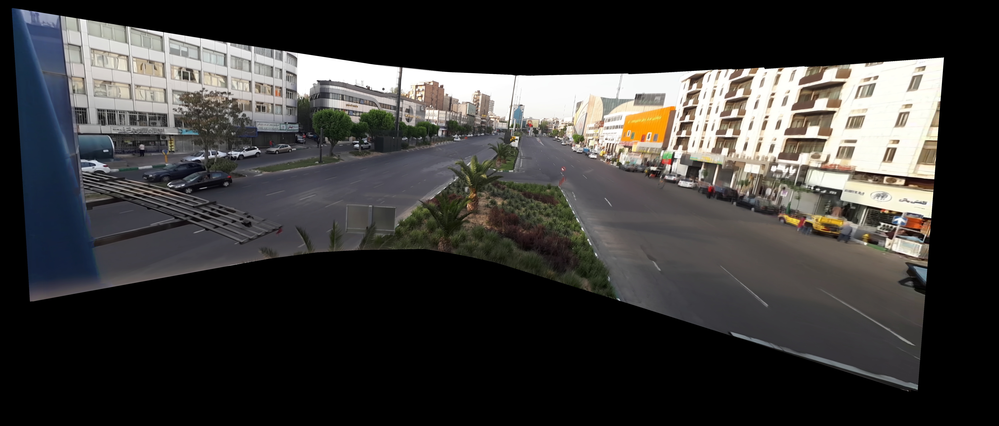

In [45]:
cv2.imwrite(f'{SAVE_PATH}res06-background-panorama.jpg', background_img)
cv2_imshow(background_img)

In [46]:
triangle = [(3250, 800), (8000, 2600), (3200, 2000), (-2300, 1800)]
rect = [(2800, 1100), (3500, 1050), (4000, 2000), (1800, 2000)]
street_mask = cv2.fillPoly(np.zeros_like(full_mask), np.array([triangle]), color=1) - cv2.fillPoly(np.zeros_like(full_mask), np.array([rect]), color=1) 

# Part 5 - Background Video

For this part we have to create a background video with same form as input video. To make this we just simply re-transform back the points from background panorama image to a frame with size of input frame. Then we stack them and output the desired video. 

We just need to calculate the inverse of translation matrix times homography matrix of that frame to 450th frame,



In [47]:
background_frames = []
street_masks = []

In [48]:
import imageio

In [49]:
for i in range(900):
  img = cv2.warpPerspective(background_img, np.linalg.inv(transformation_matrix @  final_homographies[i]), (WIDTH, HEIGHT))
  background_frames.append(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

imageio.mimsave(f'{SAVE_PATH}res07-background-video.mp4', background_frames, fps=30, macro_block_size = None)
background_frames = []
street_masks = []

# Part 6 - Foreground Seperation

Now that we have background video and the original video we can easily calculate the difference between these 2 images. By setting a threshold we can see the pixels that have far distance with background video. Since they differ that much, we can say that those pixels are probably out foreground objects. So we mask them by Red and stack them together to create the video output.

I tried to use superpixels to make the selections better and more accurate but it took crazy amount of computation power and the final result wasn't that far ahead. 

Finally in order to fill unwanted holes in the selection, I used close morphology to select the pixels that have not been selected because of the high correlation with the background. I also used median filter for the same purpose.

Also as we can see at the end of the video, there are much more unwanted areas that have been selected. Thats because the homography matrices are not that accurate at the end since the camera moves faster.

In [50]:
foreground = []

In [ ]:
threshhold = 35
threshhold_mean = 30

for i in range(len(foreground),900, 1):
  current_mask = cv2.warpPerspective(street_mask, np.linalg.inv(transformation_matrix @  final_homographies[i]), (WIDTH, HEIGHT)).astype(bool)
  back_img = cv2.warpPerspective(background_img, np.linalg.inv(transformation_matrix @  final_homographies[i]), (WIDTH, HEIGHT))
  main_img = frames[i].copy().astype(np.float32)
  max_diff = np.max(np.abs(back_img- main_img), axis=-1)
  mean_diff = np.mean(np.abs(back_img- main_img), axis=-1)
  diff_1 =  np.where(max_diff > threshhold, 1, 0).astype(np.uint8) * current_mask
  diff_2 =  np.where(mean_diff > threshhold_mean, 1, 0).astype(np.uint8) * current_mask
  diff = np.where(diff_1 + diff_2 > 0, 1, 0).astype(np.uint8) * current_mask
  noise_diff = diff.copy()

  for j in range(15):
    diff = cv2.medianBlur(diff, 7)

  diff = cv2.morphologyEx(diff, cv2.MORPH_CLOSE, np.ones((3, 3)), iterations=7)

  diff *= current_mask.astype(np.uint8)
  car_mask = np.zeros_like(main_img)
  

  car_mask[:, :, 2] += diff * 255
  main_img = (0.3 * car_mask + 0.7 * main_img).astype(np.uint8)
  foreground.append(cv2.cvtColor(main_img, cv2.COLOR_BGR2RGB))

In [ ]:
imageio.mimsave(f'{SAVE_PATH}res08-foreground-video.mp4', foreground, fps=30, macro_block_size = None)

In [ ]:
imageio.mimsave(f'/content/drive/MyDrive/res08-foreground-video.mp4', foreground, fps=30, macro_block_size = None)
foreground = None

# Part 7 - Wider Video

We have generate the background image in section 5. We use that image here again to make the video wider. In order to make the video wider we just have to take more from the reference background image. For earlier frames we take out the extra space from right of the image and for ending frames we take the space from of left of the images. 

We caluculate the transition for first frame and last frame and interpolate these transformation.

So the more we go forward the less it takes the space from right of the image and the more it takes from the left of the image.

In this way we expand our width without actually changing homographies or having black regions.

In [ ]:
images = []

for i in range(0, 900):
  current_targets = cv2.perspectiveTransform(np.float32(P).reshape(-1, 1, 2), final_homographies[i]).astype(np.int32)
  current_points = np.float32(P).reshape(-1, 1, 2)
  current_points[:, 0, 0] += (i/850) ** 1.5 * 0.5 * WIDTH 
  H, mask = cv2.findHomography(current_points, current_targets)
  img = cv2.warpPerspective(background_img, np.linalg.inv(transformation_matrix @  H), (int(1.5 * WIDTH), HEIGHT))
  images.append(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

imageio.mimsave(f'{SAVE_PATH}res09-background-video-wider.mp4', images, fps=30, macro_block_size = None)
imageio.mimsave(f'/content/drive/MyDrive/res09-background-video-wider.mp4', images, fps=30, macro_block_size = None)
images = None

# Part 8 - Stabilizer

A shaky video has some abrupt changes in movement. In order to stabilize a video, we first get the path that camera is moving on. Then we smooth that path by using a low pass filter or fitting a polynomial to that path. Here we use **savitzky_golay** as our smoothing backbone. Now that we have both paths we just need to find the transformation that maps a frame in original path to the same frame in smooth path. We just repeat that for each frame and stack the frames to acheive the final result. 

To find the camera path, we first need the homography matrix that maps each frame to its next frame. Since we have all the homographies that maps to 450th frame, we can simply calculate that:

$$H_{i → i+1} = H_{i → 450} × H_{i+1 → 450}^{-1}$$

Now that we have all these matrices, we consider 4 points on the first frame of the video. then we get their location on next frame by transforming them using homography matrix that we calculated. We do that for every frame and record the coordinates of those points along the way. Now we have the path of camera for those 4 points.

Now we smooth this path and find a homography matrix that matches $k$th coordinates of original path to $k$th coordinates on the smooth path.

At the end we traverese this path. For each frame we know the matrix that matches them to the smooth frame. Therefore we can have our shakeless video by stacking those frames on top of each other.

I cropped the video for 10 pixels to hide the black regions but for completly hiding them we have to use a higher margin. So i'd rather to keep the view and show  a little how frames gets transformed.

For path smoothing I used **savitzky golay**. I tried low pass filter by using fft as well but this worked better for me. This algorithm takes a odd size window size and fit a polynomial of order n to that window. Finally it smooths the path and we can find our homographies.

I used a window size of 151 and order 3 for the sake of this experiment and it worked out good enough.


I used 25 points instaed of 4 to use outlier rejection and have a better robustness.

In [52]:
def smooth_signal(y, window_size, order, deriv=0, rate=1):
    window_size = np.abs(int(window_size))
    order = np.abs(int(order))
    order_range = np.arange(order+1)
    half_window = (window_size -1) // 2
    b = np.mat([[k**i for i in order_range] for k in range(-half_window, half_window+1)])
    m = np.linalg.pinv(b).A[deriv] * rate**deriv * factorial(deriv)
    firs_tvals = y[0] - np.abs( y[1:half_window+1][::-1] - y[0] )
    last_vals = y[-1] + np.abs(y[-half_window-1:-1][::-1] - y[-1])
    y = np.concatenate((firs_tvals, y, last_vals))
    return np.convolve( m[::-1], y, mode='valid')

In [53]:
camera_path = []
consequent_homographies = []
m, l = 5, 5
X = np.linspace(1000, 1900, m)
Y = np.linspace(400, 1000, l)
sample_points = np.meshgrid(X, Y)
before_points = np.float32(sample_points).copy().reshape(-1, 1, 2)
for i in range(899):
  H = final_homographies[i] @ np.linalg.inv(final_homographies[i+1])
  current_points= cv2.perspectiveTransform(np.float32(before_points), H)
  camera_path.append(np.subtract(current_points, before_points))
  consequent_homographies.append(H)
  before_points = current_points.copy()

In [54]:
consequent_homographies = np.array(consequent_homographies)
camera_path = np.array(camera_path)

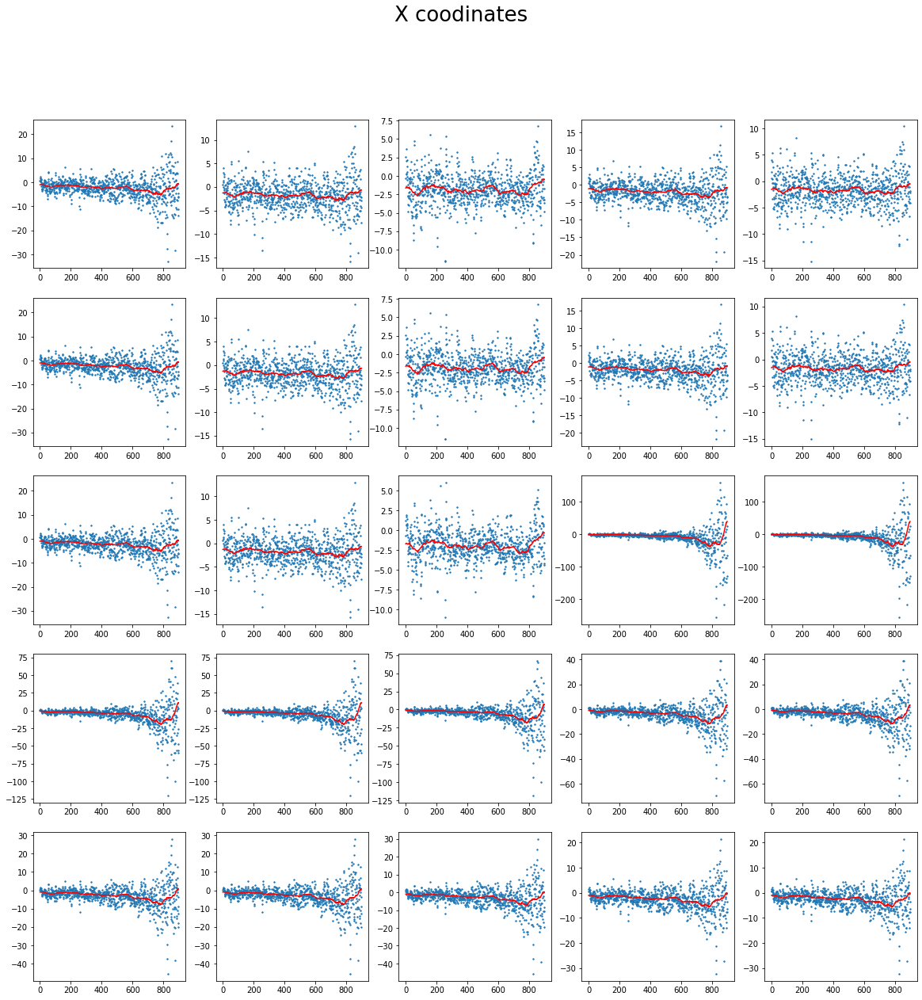

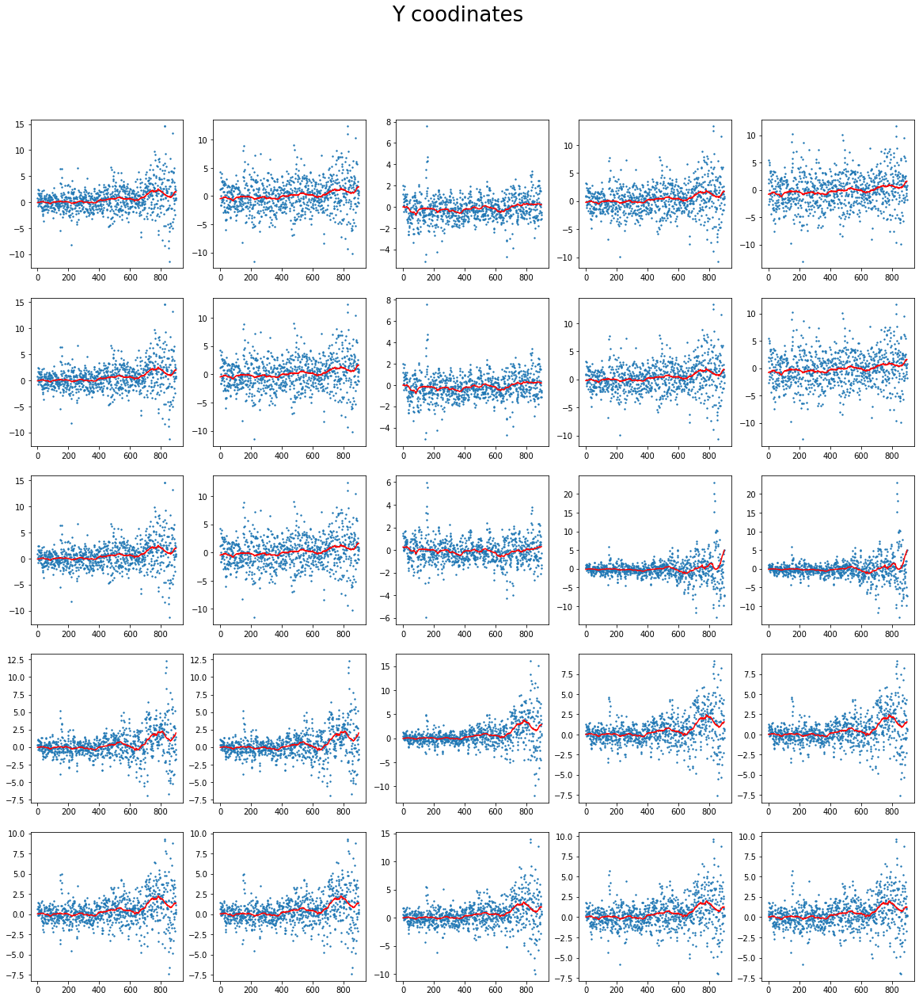

In [55]:
fig, axs = plt.subplots(m, l, figsize=(20, 20))

fig.suptitle('X coodinates', fontsize=26)

for i in range(m):
  for j in range(l):
      x = np.arange(899)
      t = i * m + j
      y = camera_path[:, t, 0,  0]
      y_hat = smooth_signal(y, 151, 3)
      axs[i, j].scatter(x, y, s=2)
      axs[i, j].plot(x, y_hat, 'red')

plt.show()

fig, axs = plt.subplots(m, l, figsize=(20, 20))

fig.suptitle('Y coodinates', fontsize=26)

for i in range(m):
  for j in range(l):
      x = np.arange(899)
      t = i * m + j
      y = camera_path[:, t, 0, 1]
      y_hat = smooth_signal(y, 151, 3)
      axs[i, j].scatter(x, y, s=2)
      axs[i, j].plot(x, y_hat, 'red')

plt.show()

In [56]:
smooth_move = np.zeros_like(camera_path)
for i in range(m * l):
  for j in range(2):
    x = np.arange(899)
    y = camera_path[:, i, 0,  j]
    y_prime =  smooth_signal(y, 151, 3)
    smooth_move[:, i, 0,  j] = y_prime

In [57]:
optimal_homorgraphies= []
current_points = np.float32(sample_points).copy().reshape(-1, 1, 2)
for i in range(899):
  next_points = current_points + smooth_move[i]
  H, _ = cv2.findHomography(current_points, next_points, cv2.RANSAC)
  optimal_homorgraphies.append(H)
  current_points = next_points

In [58]:
optimal_homorgraphies = np.array(optimal_homorgraphies)

In [59]:
stabilized_frames = []
margin = 10
stabilized_frames.append(cv2.cvtColor(frames[0], cv2.COLOR_BGR2RGB)[margin:-margin, margin:-margin])

In [60]:
current_H_path = np.eye(3)
current_smooth_path = np.eye(3)
for i in range(0, 899, 1):
  current_H_path = current_H_path @ consequent_homographies[i]
  current_smooth_path = current_smooth_path @ optimal_homorgraphies[i]
  t = current_smooth_path @ np.linalg.inv(current_H_path)
  current_frame = frames[i+1]
  stabilized_frame = cv2.warpPerspective(current_frame, t, (WIDTH, HEIGHT))
  stabilized_frames.append(cv2.cvtColor(stabilized_frame, cv2.COLOR_BGR2RGB)[margin:-margin, margin:-margin])

imageio.mimsave(f'{SAVE_PATH}res10-video-shakeless.mp4', stabilized_frames, fps=30, macro_block_size = None)

In [61]:
!apt-get install texlive texlive-xetex texlive-latex-extra pandoc
!pip install pypandoc

from google.colab import drive

!cp "/content/drive/MyDrive/Colab Notebooks/Vision-Panorama.ipynb" "/content/"

Reading package lists... Done
Building dependency tree       
Reading state information... Done
pandoc is already the newest version (1.19.2.4~dfsg-1build4).
texlive is already the newest version (2017.20180305-1).
texlive-latex-extra is already the newest version (2017.20180305-2).
texlive-xetex is already the newest version (2017.20180305-1).
The following packages were automatically installed and are no longer required:
  libnvidia-common-460 nsight-compute-2020.2.0
Use 'apt autoremove' to remove them.
0 upgraded, 0 newly installed, 0 to remove and 42 not upgraded.


In [62]:
!jupyter nbconvert --to PDF "/content/Vision-Panorama.ipynb"

[NbConvertApp] Converting notebook /content/Vision-Panorama.ipynb to PDF
[NbConvertApp] Support files will be in Vision-Panorama_files/
[NbConvertApp] Making directory ./Vision-Panorama_files
[NbConvertApp] Making directory ./Vision-Panorama_files
[NbConvertApp] Making directory ./Vision-Panorama_files
[NbConvertApp] Making directory ./Vision-Panorama_files
[NbConvertApp] Writing 136979 bytes to ./notebook.tex
[NbConvertApp] Building PDF
[NbConvertApp] Running xelatex 3 times: ['xelatex', './notebook.tex', '-quiet']
[NbConvertApp] Running bibtex 1 time: ['bibtex', './notebook']
[NbConvertApp] WARNING | bibtex had problems, most likely because there were no citations
[NbConvertApp] PDF successfully created
[NbConvertApp] Writing 672305 bytes to /content/Vision-Panorama.pdf
